# Conditional CycleGAN for MRI T1 → T2 Translation (IXI Dataset)

In this notebook, we demonstrate how to:
1. Download and prepare the **IXI MRI Dataset** (T1 & T2 images).
2. Load and inspect slices with **Nibabel**.
3. Build a **CycleGAN** for bidirectional T1↔T2 image-to-image translation.
4. Train and visualize results.


## Table of Contents
- Introduction & Key Concepts
- Environment Setup & Dependencies
- Download & Prepare IXI MRI Data
- Data Loading & Preprocessing (Slice-Based)
- Conditional CycleGAN Model
- Training Loop
- Visualization & Conclusion


## Introduction & Key Concepts
 
### What is CycleGAN?
CycleGAN learns a mapping between two domains (X and Y) with **unpaired** data by enforcing a **cycle-consistency** constraint. The key operations are:

1. Forward cycle consistency (X → Y → X):
$x \rightarrow G_{X\rightarrow Y}(x) \rightarrow G_{Y\rightarrow X}(G_{X\rightarrow Y}(x)) \approx x$

2. Backward cycle consistency (Y → X → Y): 
$y \rightarrow G_{Y\rightarrow X}(y) \rightarrow G_{X\rightarrow Y}(G_{Y\rightarrow X}(y)) \approx y$

3. Adversarial losses:
- For generator $G_{X\rightarrow Y}$: $\mathcal{L}_{GAN}(G_{X\rightarrow Y}, D_Y, X, Y)$
- For generator $G_{Y\rightarrow X}$: $\mathcal{L}_{GAN}(G_{Y\rightarrow X}, D_X, Y, X)$

4. Full objective:
$\mathcal{L}_{CycleGAN} = \mathcal{L}_{GAN}(G_{X\rightarrow Y}, D_Y, X, Y) + \mathcal{L}_{GAN}(G_{Y\rightarrow X}, D_X, Y, X) + \lambda\mathcal{L}_{cyc}(G_{X\rightarrow Y}, G_{Y\rightarrow X})$

 where $\lambda$ controls the importance of cycle consistency relative to the adversarial objectives.


### Why T1→T2?
- Certain T2-weighted characteristics (e.g., fluid contrast) are highly relevant diagnostically.
- Generating T2 from T1 can reduce scanning time or serve as data augmentation.

### Data Note
- The [IXI Dataset](https://brain-development.org/ixi-dataset/) contains ~600 MR volumes.
- Each subject has T1, T2, PD, etc.
- We’ll only focus on **T1** and **T2** here.

## Environment Setup & Dependencies
Below we install the necessary libraries. We also need `nibabel` for reading NIfTI MRI files.

In [2]:
# Create and activate conda environment from notebook
import sys
import subprocess

def create_conda_env():
    # Create new conda environment
    subprocess.run(['conda', 'create', '-n', 'mri-cyclegan', 'python=3.8', '-y'])
    
    # Install ipykernel to make env available as notebook kernel 
    subprocess.run(['conda', 'install', '-n', 'mri-cyclegan', 'ipykernel', '-y'])
    
    # Add environment as Jupyter kernel
    subprocess.run(['conda', 'run', '-n', 'mri-cyclegan', 'python', '-m', 'ipykernel', 'install', '--user', '--name', 'mri-cyclegan', '--display-name', 'Python (mri-cyclegan)'])
    
    print("Created conda environment 'mri-cyclegan' and added it as a Jupyter kernel")
    print("Please restart the notebook and select the 'Python (mri-cyclegan)' kernel")
    print("Then run the package installation cell below")

# Check if environment exists by trying to get its info
try:
    env_check = subprocess.run(['conda', 'env', 'list'], capture_output=True, text=True)
    if 'mri-cyclegan' in env_check.stdout:
        print("Environment 'mri-cyclegan' already exists")
    else:
        create_conda_env()
except Exception as e:
    print(f"Error checking conda environment: {e}")
    create_conda_env()

# After restarting with new kernel, install packages
if 'mri-cyclegan' in sys.executable:
    # Check system platform
    import platform
    system = platform.system()
    print(f"Operating System: {system}")

    # Check for CUDA GPUs
    has_nvidia = False
    if system == "Linux" or system == "Windows":
        try:
            nvidia_output = subprocess.check_output(['nvidia-smi']).decode('utf-8')
            has_nvidia = True
            print("NVIDIA GPU detected")
        except:
            print("No NVIDIA GPU detected")

    # Check for Apple Silicon
    has_mps = False
    if system == "Darwin":  # macOS
        if platform.processor() == 'arm':
            has_mps = True
            print("Apple Silicon detected")
        else:
            print("Intel Mac detected")

    # Install packages in conda environment
    if has_nvidia:
        subprocess.run(['conda', 'install', 'pytorch', 'torchvision', 'torchaudio', 'pytorch-cuda=11.8', '-c', 'pytorch', '-c', 'nvidia', '-y'])
    elif has_mps:
        subprocess.run(['conda', 'install', 'pytorch', 'torchvision', 'torchaudio', '-c', 'pytorch', '-y'])
    else:
        subprocess.run(['conda', 'install', 'pytorch', 'torchvision', 'torchaudio', 'cpuonly', '-c', 'pytorch', '-y'])

    subprocess.run(['conda', 'install', 'matplotlib', 'pillow', 'scikit-image', 'pandas', 'numpy', 'tqdm', 'scipy', '-y'])
    subprocess.run(['conda', 'install', 'nibabel', '-c', 'conda-forge', '-y'])
else:
    print("Please restart notebook and select the 'Python (mri-cyclegan)' kernel first")

Environment 'mri-cyclegan' already exists
Operating System: Darwin
Apple Silicon detected
Channels:
 - pytorch
 - defaults
Platform: osx-arm64
Solving environment: ...working... done

# All requested packages already installed.

Channels:
 - defaults
 - pytorch
Platform: osx-arm64
Solving environment: ...working... done

## Package Plan ##

  environment location: /Users/mebrahimkhani/miniconda3/envs/mri-cyclegan

  added / updated specs:
    - matplotlib
    - numpy
    - pandas
    - pillow
    - scikit-image
    - scipy
    - tqdm


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    aom-3.6.0                  |       h313beb8_0         2.2 MB
    blosc-1.21.3               |       h313beb8_0          41 KB
    bottleneck-1.3.7           |   py38hbda83bc_0         107 KB
    brotli-1.0.9               |       h80987f9_9          20 KB
    brotli-bin-1.0.9           |       h80987f9_9     

## Download & Prepare IXI MRI Data


In [4]:
# Import required modules
import os
import urllib.request
import pathlib

# Since we're in a notebook, we'll set the parent directory relative to current working directory
parent_dir = pathlib.Path(os.getcwd()).parent

# URLs for the tar files
t1_url = "http://biomedic.doc.ic.ac.uk/brain-development/downloads/IXI/IXI-T1.tar"
t2_url = "http://biomedic.doc.ic.ac.uk/brain-development/downloads/IXI/IXI-T2.tar"

# Download tar files if they don't exist
for url, filename in [(t1_url, "IXI-T1.tar"), (t2_url, "IXI-T2.tar")]:
    filepath = parent_dir / filename
    if not filepath.exists():
        print(f"Downloading {filename}...")
        urllib.request.urlretrieve(url, filepath)
    else:
        print(f"{filename} already exists.")

# Create data directories if they don't exist
data_dir = parent_dir / "data"
t1_dir = data_dir / "IXI_T1"
t2_dir = data_dir / "IXI_T2"

t1_dir.mkdir(parents=True, exist_ok=True)
t2_dir.mkdir(parents=True, exist_ok=True)

# Extract T1 and T2 tar files into their respective directories
import subprocess
subprocess.run(['tar', '-xf', parent_dir / "IXI-T1.tar", '-C', t1_dir])
subprocess.run(['tar', '-xf', parent_dir / "IXI-T2.tar", '-C', t2_dir])

# Count number of T1 and T2 files
# Filter and count T1 NIfTI files in the T1 directory
t1_count = len(list(t1_dir.glob('*.nii.gz')))
# Filter and count T2 NIfTI files in the T2 directory  
t2_count = len(list(t2_dir.glob('*.nii.gz')))

print(f"Data extracted successfully. Found {t1_count} T1 scans and {t2_count} T2 scans.")

IXI-T1.tar already exists.
IXI-T2.tar already exists.
Data extracted successfully. Found 581 T1 scans and 578 T2 scans.


## Data Loading & Preprocessing (Slice-Based)

We'll load a few T1/T2 volumes, extract 2D slices, and pair them by subject if available. In a purely unpaired setting, we’d randomize them. In many cases, IXI has T1 and T2 from the same subject.

### Inspect Example Slices

Found 577 paired T1/T2 datasets

Patient 1:
T1 data size: (256, 256, 150)
T2 data size: (256, 256, 130)

Patient 2:
T1 data size: (256, 256, 150)
T2 data size: (256, 256, 130)

Patient 3:
T1 data size: (256, 256, 150)
T2 data size: (256, 256, 130)

Patient 4:
T1 data size: (256, 256, 150)
T2 data size: (256, 256, 130)


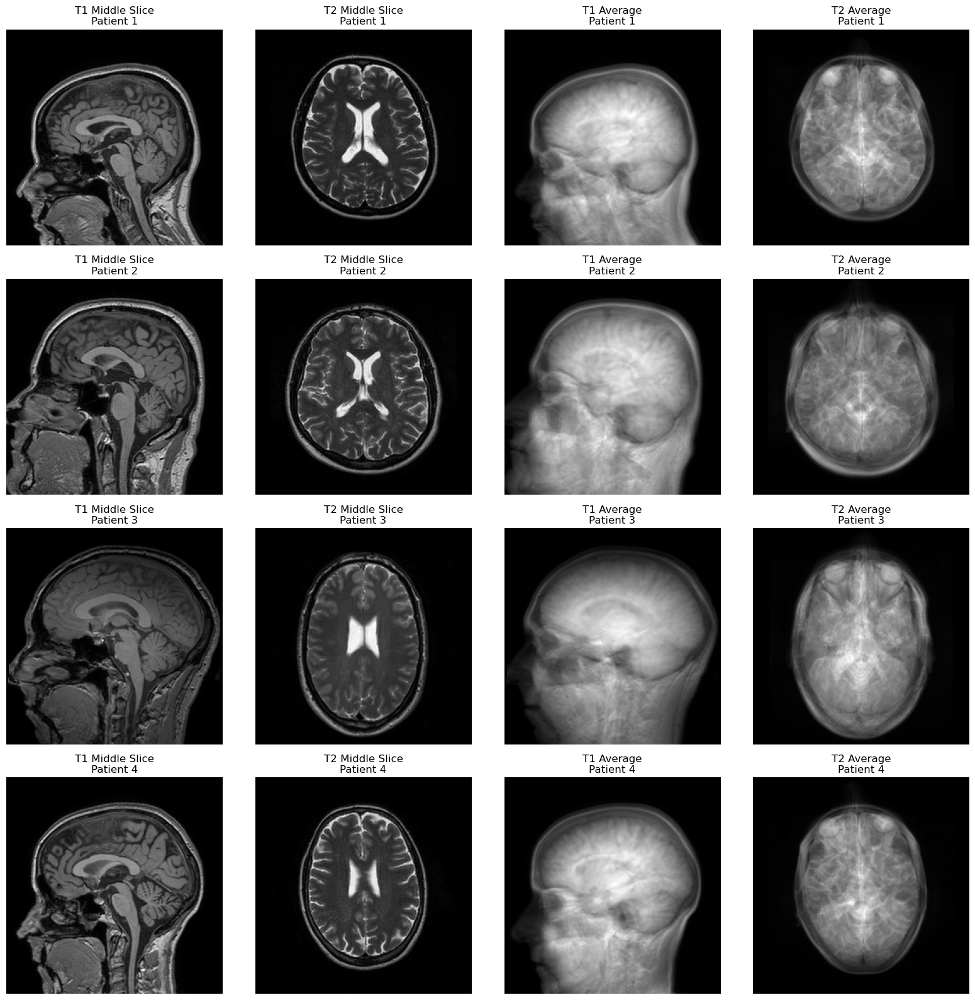

In [5]:
# Import required libraries
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
import random
import pathlib

# Get the parent directory (one level above notebooks)
parent_dir = pathlib.Path(os.getcwd()).parent
data_dir = parent_dir / "data"

# Get list of T1 files ending in .nii.gz from T1 directory
t1_files = sorted([f for f in os.listdir(data_dir / 'IXI_T1') if f.endswith('.nii.gz')])
# Get list of T2 files ending in .nii.gz from T2 directory 
t2_files = sorted([f for f in os.listdir(data_dir / 'IXI_T2') if f.endswith('.nii.gz')])

# Initialize empty list to store paired T1/T2 files
paired_data = []
# Loop through T1 files to find matching T2 files
for t1f in t1_files:
    # Extract subject ID from filename (e.g. "002" from "IXI002-Guys-0828-T1.nii.gz")
    subject_id = t1f.split('-')[0][3:]
    # Find matching T2 file with same subject ID
    matching_t2 = [t2f for t2f in t2_files if t2f.split('-')[0][3:] == subject_id]
    # If matching T2 file found, add pair to list
    if matching_t2:
        paired_data.append((t1f, matching_t2[0]))

# Print number of paired datasets found
print(f"Found {len(paired_data)} paired T1/T2 datasets")

# Function to load NIfTI file and get data array
def load_nifti(path):
    img = nib.load(path)
    data = img.get_fdata()
    return data

# Display sample slices if enough pairs found
if len(paired_data) >= 4:
    # Randomly select 4 pairs to display
    selected_pairs = random.sample(paired_data, 4)
    
    # Create figure with subplots
    plt.figure(figsize=(16, 16))
    for idx, (t1_file, t2_file) in enumerate(selected_pairs):
        # Construct full file paths using parent directory
        t1_path = data_dir / 'IXI_T1' / t1_file
        t2_path = data_dir / 'IXI_T2' / t2_file
        
        # Load T1 and T2 data
        t1_data = load_nifti(t1_path)
        t2_data = load_nifti(t2_path)
        
        # Print data dimensions for each patient
        print(f"\nPatient {idx+1}:")
        print(f"T1 data size: {t1_data.shape}")
        print(f"T2 data size: {t2_data.shape}")
        
        # Calculate middle slice index and average projections
        slice_idx = t1_data.shape[2] // 2
        t1_avg = np.mean(t1_data, axis=2)
        t2_avg = np.mean(t2_data, axis=2)
        
        # Plot T1 middle slice
        plt.subplot(4, 4, idx*4 + 1)
        plt.imshow(t1_data[:,:,slice_idx].T, cmap="gray", origin="lower")
        plt.title(f"T1 Middle Slice\nPatient {idx+1}")
        plt.axis("off")
        
        # Plot T2 middle slice
        plt.subplot(4, 4, idx*4 + 2)
        plt.imshow(t2_data[:,:,slice_idx].T, cmap="gray", origin="lower")
        plt.title(f"T2 Middle Slice\nPatient {idx+1}")
        plt.axis("off")
        
        # Plot T1 average projection
        plt.subplot(4, 4, idx*4 + 3)
        plt.imshow(t1_avg.T, cmap="gray", origin="lower")
        plt.title(f"T1 Average\nPatient {idx+1}")
        plt.axis("off")
        
        # Plot T2 average projection
        plt.subplot(4, 4, idx*4 + 4)
        plt.imshow(t2_avg.T, cmap="gray", origin="lower")
        plt.title(f"T2 Average\nPatient {idx+1}")
        plt.axis("off")
    
    # Adjust subplot layout and display
    plt.tight_layout()
    plt.show()
else:
    print("Not enough paired T1/T2 files found. Please check data directories.")

## MRI Volume Animation


In [9]:
# Import required libraries for animation and display
import matplotlib.animation as animation
from IPython.display import HTML

def create_mri_animation(t1_data, t2_data, interval=100):
    """
    Creates an animation of T1 and T2 slices side by side
    
    Args:
        t1_data: 3D numpy array of T1 scan
        t2_data: 3D numpy array of T2 scan 
        interval: Time between frames in milliseconds
    """
    # Create figure with two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    
    # Calculate min/max values for consistent scaling
    t1_vmin, t1_vmax = np.percentile(t1_data, [2, 98])  # Using percentiles to avoid outliers
    t2_vmin, t2_vmax = np.percentile(t2_data, [2, 98])
    
    # Initialize plots with first slice of each scan and proper value ranges
    im1 = ax1.imshow(t1_data[:,:,0].T, cmap='gray', origin='lower',
                     vmin=t1_vmin, vmax=t1_vmax)
    im2 = ax2.imshow(t2_data[:,:,0].T, cmap='gray', origin='lower',
                     vmin=t2_vmin, vmax=t2_vmax)
    
    # Set titles and turn off axes
    ax1.set_title('T1 Scan')
    ax2.set_title('T2 Scan')
    ax1.axis('off')
    ax2.axis('off')
    
    # Get number of slices (use min to handle different sizes)
    n_slices = min(t1_data.shape[2], t2_data.shape[2])
    
    # Animation update function
    def update(frame):
        # Update both plots with current slice
        im1.set_array(t1_data[:,:,frame].T)
        im2.set_array(t2_data[:,:,frame].T)
        return [im1, im2]
    
    # Create animation object
    anim = animation.FuncAnimation(
        fig,
        update,
        frames=n_slices-1,  # Subtract 1 to avoid index out of bounds
        interval=interval,
        blit=True
    )
    
    # Close static plot
    plt.close()
    
    # Return HTML animation
    return HTML(anim.to_jshtml())

# Example usage for one patient
if len(paired_data) > 0:
    # Get first pair of T1/T2 scans
    t1_file, t2_file = paired_data[0]
    
    # Load scan data from files
    t1_path = os.path.join('data/IXI_T1', t1_file)
    t2_path = os.path.join('data/IXI_T2', t2_file)
    t1_data = load_nifti(t1_path)
    t2_data = load_nifti(t2_path)
    
    # Print data dimensions
    print(f"T1 data size: {t1_data.shape}")
    print(f"T2 data size: {t2_data.shape}")
    
    # Create and display animation
    animation_html = create_mri_animation(t1_data, t2_data)
    display(animation_html)
else:
    print("No paired T1/T2 files found. Please check data directories.")

T1 data size: (256, 256, 150)
T2 data size: (256, 256, 130)


Animation size has reached 21002181 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# MRI T1/T2 Dataset Class

This class implements a PyTorch Dataset for handling paired or unpaired T1 and T2 MRI scans. It's designed to be memory-efficient and flexible for different training scenarios.

## Key Features

### 1. Initialization Parameters
- `t1_dir`, `t2_dir`: Directories containing T1 and T2 NIfTI files (`.nii.gz`)
- `slice_mode`: 'middle' or 'random' slice selection
- `paired`: Boolean for paired/unpaired data handling
- `transform`: Optional PyTorch transforms
- `cache_size`: Number of volumes to keep in memory

### 2. Memory Management
- Implements volume caching with configurable size
- Cleans up unused volumes to prevent memory overflow
- Validates volumes before processing

### 3. Data Processing
- Supports both paired and unpaired training scenarios
- Normalizes slices using volume-specific statistics
- Converts 2D slices to PyTorch tensors
- Handles proper orientation with transpose operations

### 4. Quality Control
- Validates volume dimensions (minimum 64×64)
- Checks for NaN values
- Ensures consistent slice selection between paired volumes



Testing Dataloader:
Batch shapes - T1: torch.Size([1, 1, 256, 256]), T2: torch.Size([1, 1, 256, 256])
Value ranges - T1: [-1.000, 0.278], T2: [-1.000, 0.791]


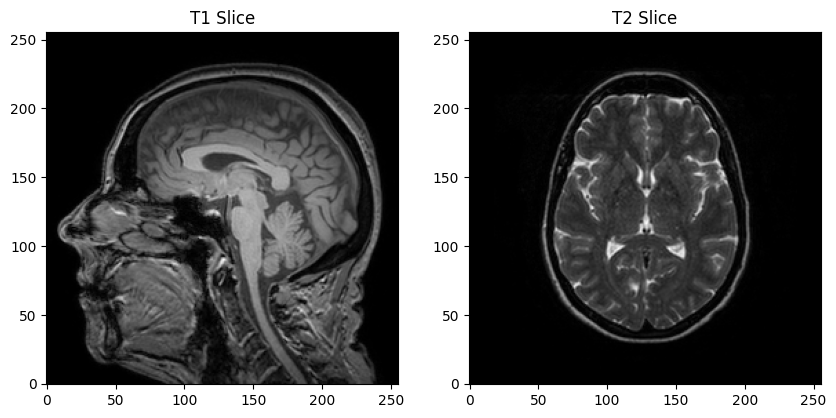


Testing memory management:
Initial batch memory location: cpu
Memory test passed


In [35]:
import os
import nibabel as nib
import numpy as np
import torch
import random
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import matplotlib.pyplot as plt

# Define dataset class at module level for pickling
class MRIT1T2Dataset(Dataset):
    def __init__(self, t1_dir, t2_dir, slice_mode='middle', paired=True, transform=None, cache_size=0):
        """
        Args:
            t1_dir: Directory containing T1 scans
            t2_dir: Directory containing T2 scans
            slice_mode: 'middle' or 'random'
            paired: If True, uses paired T1-T2 data, else random unpaired selection
            transform: Optional transforms to apply
            cache_size: Number of volumes to cache in memory (0 for no caching)
        """
        super().__init__()
        
        self.t1_dir = t1_dir
        self.t2_dir = t2_dir
        self.transform = transform
        self.slice_mode = slice_mode
        self.paired = paired
        self.cache_size = cache_size
        
        # Get file lists
        self.t1_files = sorted([f for f in os.listdir(t1_dir) if f.endswith('.nii.gz')])
        self.t2_files = sorted([f for f in os.listdir(t2_dir) if f.endswith('.nii.gz')])
        
        # For paired training, find matching T1-T2 pairs
        if self.paired:
            self.paired_files = []
            for t1f in self.t1_files:
                subject_id = t1f.split('-')[0][3:]
                matching_t2 = [t2f for t2f in self.t2_files if t2f.split('-')[0][3:] == subject_id]
                if matching_t2:
                    self.paired_files.append((t1f, matching_t2[0]))
            print(f"Found {len(self.paired_files)} paired T1/T2 datasets")
            self.data_files = self.paired_files
        else:
            self.data_files = [(t1f, None) for t1f in self.t1_files]
        
        # Initialize cache
        self.cache = {}

    def _load_and_validate_volume(self, filename, is_t1=True):
        """Load and validate a single volume"""
        dir_path = self.t1_dir if is_t1 else self.t2_dir
        filepath = os.path.join(dir_path, filename)
        
        # Check if volume is in cache
        if filepath in self.cache:
            vol = self.cache[filepath]
        else:
            # Load volume
            vol = nib.load(filepath).get_fdata()
            
            # Validate volume
            if not self.is_valid_volume(vol):
                raise ValueError(f"Invalid volume: {filename}")
            
            # Cache volume if needed
            if len(self.cache) < self.cache_size:
                self.cache[filepath] = vol
    
        # Calculate stats
        stats = (float(vol.min()), float(vol.max()))
        
        return vol, stats

    def is_valid_volume(self, vol):
        """Check if volume meets quality criteria"""
        min_size = 64
        return (vol.shape[0] >= min_size and 
                vol.shape[1] >= min_size and 
                vol.shape[2] >= 1 and 
                not np.any(np.isnan(vol)))

    def __len__(self):
        return len(self.data_files)

    def get_slice_idx(self, volume):
        """Get slice index based on slice_mode"""
        if self.slice_mode == 'middle':
            return volume.shape[2] // 2
        else:  # random
            return random.randint(0, volume.shape[2] - 1)

    def __getitem__(self, idx):
        t1_file, t2_file = self.data_files[idx]
        
        # Load T1 volume and get stats
        t1_vol, t1_stats = self._load_and_validate_volume(t1_file, is_t1=True)
        
        if self.paired:
            # Load matching T2 volume
            t2_vol, t2_stats = self._load_and_validate_volume(t2_file, is_t1=False)
        else:
            # Random T2 volume for unpaired
            random_t2_idx = random.randint(0, len(self.t2_files) - 1)
            t2_vol, t2_stats = self._load_and_validate_volume(self.t2_files[random_t2_idx], is_t1=False)
            
        # Get appropriate slice indices for each volume
        t1_slice_idx = self.get_slice_idx(t1_vol)
        t2_slice_idx = self.get_slice_idx(t2_vol) if not self.paired else min(t1_slice_idx, t2_vol.shape[2]-1)


        # Extract and normalize slices
        t1_slice = self.normalize_slice(t1_vol[:,:,t1_slice_idx], t1_stats)
        t2_slice = self.normalize_slice(t2_vol[:,:,t2_slice_idx], t2_stats)

        # Convert to tensors
        t1_tensor = torch.from_numpy(t1_slice).float().unsqueeze(0)
        t2_tensor = torch.from_numpy(t2_slice).float().unsqueeze(0)

        if self.transform:
            t1_tensor = self.transform(t1_tensor)
            t2_tensor = self.transform(t2_tensor)

        # Clear from memory if not cached
        if t1_file not in self.cache:
            del t1_vol
        if t2_file not in self.cache:
            del t2_vol

        return {'T1': t1_tensor, 'T2': t2_tensor}

    @staticmethod
    def normalize_slice(slice_data, stats):
        """Normalize slice using pre-computed statistics"""
        min_val, max_val = stats
        return (slice_data - min_val) / (max_val - min_val + 1e-8)

if __name__ == '__main__':
    # Example usage with memory-efficient settings:
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.Normalize(mean=[0.5], std=[0.5])
    ])

    # Create dataset
    dataset = MRIT1T2Dataset(
        t1_dir='data/IXI_T1',
        t2_dir='data/IXI_T2',
        slice_mode='middle',
        paired=False,
        transform=transform,
        cache_size=2  # Cache only 2 volumes
    )

    # Create data loader
    dataloader = DataLoader(
        dataset,
        batch_size=1,
        shuffle=True,
        num_workers=0,
        pin_memory=True
    )

    # Test dataloader
    def test_dataloader(loader):
        print("\nTesting Dataloader:")
        batch = next(iter(loader))
        t1, t2 = batch['T1'], batch['T2']
        print(f"Batch shapes - T1: {t1.shape}, T2: {t2.shape}")
        print(f"Value ranges - T1: [{t1.min():.3f}, {t1.max():.3f}], T2: [{t2.min():.3f}, {t2.max():.3f}]")
        
        # Visualize sample images - remove origin='upper' and add transpose
        plt.figure(figsize=(10, 5))
        plt.subplot(121)
        # Add .T to transpose the image for correct orientation
        plt.imshow(t1[0,0].numpy().T, cmap='gray', origin='lower')
        plt.title('T1 Slice')
        plt.subplot(122)
        # Add .T to transpose the image for correct orientation
        plt.imshow(t2[0,0].numpy().T, cmap='gray', origin='lower')
        plt.title('T2 Slice')
        plt.show()

        # Test memory management
        print("\nTesting memory management:")
        for i, batch in enumerate(loader):
            if i == 0:
                print(f"Initial batch memory location: {batch['T1'].device}")
            if i >= 2:  # Test a few batches
                break
        print("Memory test passed")

    # Run tests
    test_dataloader(dataloader)


# CycleGAN Architecture Deep Dive

## Generator Architecture
The generator follows a U-Net-like structure with residual blocks:

### 1. Input Processing & Downsampling
- **ReflectionPad2d**: Used instead of zero padding to avoid border artifacts. Reflection padding maintains the continuity of features at the borders, which is crucial for medical images where edge information is important.
- **InstanceNorm2d**: Preferred over BatchNorm for style transfer tasks because:
  - Normalizes each feature map independently
  - Better preserves instance-specific contrast
  - More stable for small batch sizes common in medical imaging

### 2. Residual Blocks
- Residual connections help maintain fine details and improve gradient flow
- Multiple residual blocks (n=9) allow the network to learn complex transformations while keeping training stable
- Each block preserves spatial dimensions, focusing on feature transformation
- Structure: Conv -> InstanceNorm -> ReLU -> Conv -> InstanceNorm with skip connection

### 3. Up/Downsampling Design
- **Downsampling**: Uses strided convolutions (stride=2) instead of pooling
  - Allows the network to learn its own spatial downsampling
  - Better preserves structural information
- **Upsampling**: Uses transposed convolutions with output padding
  - Learnable upsampling better than fixed interpolation
  - Output padding ensures exact size matching

## Discriminator Architecture
PatchGAN discriminator that classifies 70×70 overlapping patches:

- **PatchGAN**: Focus on local structure rather than global composition
  - More suitable for medical images where local texture matters
  - Fewer parameters than full-image discriminator
- **LeakyReLU**: Prevents "dying ReLU" problem in discriminator
  - Small negative slope (0.2) helps gradient flow
  - Better training stability than regular ReLU
- **Progressive Feature Extraction**: Gradually increases channels (1→64→128→256→512→1) with InstanceNorm and LeakyReLU between convolutions

## Loss Functions & Training

### 1. Multiple Loss Components
- **MSE Loss** for adversarial: More stable than binary cross-entropy
- **L1 Loss** for cycle/identity: Better preserves structural details than L2
- **Lambda Weights**: 
  - `lambda_cycle = 10.0`: Strong cycle consistency enforcement
  - `lambda_id = 0.5`: Moderate identity preservation

### 2. Learning Rate Strategy
- **Cosine Annealing**: Smooth learning rate decay
  - Better than step decay for image translation
  - Helps escape local minima
  - Final minimum rate (1e-5) prevents complete convergence
- **Separate schedulers** for generators and discriminators
  - Allows independent learning rate control
  - Helps maintain generator-discriminator balance

### 3. Optimization Settings
- **Adam** with β1=0.5: Standard for GANs
  - Lower β1 helps with training stability
  - Learning rate 2e-4 balances speed and stability

## Memory Management
- **Caching System**: Configurable volume caching
  - Balances memory usage and speed
  - Important for large medical volumes
- **Gradient Detachment**: In discriminator updates
  - Prevents unnecessary gradient computation
  - Reduces memory usage during training

This architecture is specifically tuned for medical image translation, with emphasis on:
- Preserving structural details
- Maintaining consistent contrast
- Efficient memory usage
- Training stability

In [38]:
import torch.nn as nn
import itertools

class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.conv_block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(channels, channels, kernel_size=3),
            nn.InstanceNorm2d(channels),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(channels, channels, kernel_size=3),
            nn.InstanceNorm2d(channels)
        )

    def forward(self, x):
        return x + self.conv_block(x)

class Generator(nn.Module):
    def __init__(self, input_channels=1, output_channels=1, n_res_blocks=9, n_filters=64):
        super().__init__()
        # Increase number of residual blocks for better feature learning
        # Add n_filters parameter for flexibility
        
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(input_channels, n_filters, kernel_size=7),
            nn.InstanceNorm2d(n_filters),
            nn.ReLU(True)
        ]

        # Downsampleing
        in_channels = n_filters
        for _ in range(2):
            out_channels = min(in_channels * 2, 256)  # Cap maximum channels
            model += [
                nn.Conv2d(in_channels, out_channels, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_channels),
                nn.ReLU(True)
            ]
            in_channels = out_channels

        # Residual blocks for better feature transformation
        for _ in range(n_res_blocks):
            model.append(ResidualBlock(in_channels))


        # Upsample
        out_channels = in_channels // 2
        for _ in range(2):
            model += [
                nn.ConvTranspose2d(in_channels, out_channels, 3, stride=2, padding=1, output_padding=1),
                nn.InstanceNorm2d(out_channels),
                nn.ReLU(True)
            ]
            in_channels = out_channels
            out_channels = in_channels // 2

        # Output
        model += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(64, output_channels, 7),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self, input_channels=1):
        super().__init__()
        model = [
            nn.Conv2d(input_channels, 64, 4, stride=2, padding=1),
            nn.LeakyReLU(0.2, True)
        ]
        model += [
            nn.Conv2d(64, 128, 4, stride=2, padding=1),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, True)
        ]
        model += [
            nn.Conv2d(128, 256, 4, stride=2, padding=1),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, True)
        ]
        model += [
            nn.Conv2d(256, 512, 4, stride=1, padding=1),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, True)
        ]
        model += [
            nn.Conv2d(512, 1, 4, stride=1, padding=1)
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

class CycleGAN:
    def __init__(self, device="cuda"):
        self.device = device

        # Generators
        self.G_XtoY = Generator(1, 1).to(device)
        self.G_YtoX = Generator(1, 1).to(device)

        # Discriminators
        self.D_X = Discriminator(1).to(device)
        self.D_Y = Discriminator(1).to(device)

        # Optimizers
        self.opt_G = torch.optim.Adam(
            itertools.chain(self.G_XtoY.parameters(), self.G_YtoX.parameters()),
            lr=2e-4, betas=(0.5, 0.999)
        )
        self.opt_D_X = torch.optim.Adam(self.D_X.parameters(), lr=2e-4, betas=(0.5, 0.999))
        self.opt_D_Y = torch.optim.Adam(self.D_Y.parameters(), lr=2e-4, betas=(0.5, 0.999))

        # Losses
        self.criterion_GAN = nn.MSELoss()
        self.criterion_cycle = nn.L1Loss()
        self.criterion_identity = nn.L1Loss()

        # Weights
        self.lambda_cycle = 10.0
        self.lambda_id = 0.5
        # Add learning rate scheduler
        self.scheduler_G = torch.optim.lr_scheduler.CosineAnnealingLR(
            self.opt_G, T_max=200, eta_min=1e-5
        )
        self.scheduler_D_X = torch.optim.lr_scheduler.CosineAnnealingLR(
            self.opt_D_X, T_max=200, eta_min=1e-5
        )
        self.scheduler_D_Y = torch.optim.lr_scheduler.CosineAnnealingLR(
            self.opt_D_Y, T_max=200, eta_min=1e-5
        )
        
        # Add history tracking
        self.history = {
            'G_losses': [], 'D_X_losses': [], 'D_Y_losses': [],
            'cycle_losses': [], 'identity_losses': []
        }

    def set_input(self, x, y):
        # x = T1, y = T2
        self.real_X = x.to(self.device)
        self.real_Y = y.to(self.device)

    def forward(self):
        # X->Y
        self.fake_Y = self.G_XtoY(self.real_X)
        self.rec_X = self.G_YtoX(self.fake_Y)
        # Y->X
        self.fake_X = self.G_YtoX(self.real_Y)
        self.rec_Y = self.G_XtoY(self.fake_X)

    def backward_D_basic(self, netD, real, fake):
        pred_real = netD(real)
        loss_real = self.criterion_GAN(pred_real, torch.ones_like(pred_real))

        pred_fake = netD(fake.detach())
        loss_fake = self.criterion_GAN(pred_fake, torch.zeros_like(pred_fake))

        return (loss_real + loss_fake) * 0.5

    def backward_D_X(self):
        fake_X = self.fake_X
        self.loss_D_X = self.backward_D_basic(self.D_X, self.real_X, fake_X)
        self.loss_D_X.backward()

    def backward_D_Y(self):
        fake_Y = self.fake_Y
        self.loss_D_Y = self.backward_D_basic(self.D_Y, self.real_Y, fake_Y)
        self.loss_D_Y.backward()

    def backward_G(self):
        # Adversarial X->Y
        pred_fake_Y = self.D_Y(self.fake_Y)
        self.loss_G_XtoY = self.criterion_GAN(pred_fake_Y, torch.ones_like(pred_fake_Y))

        # Adversarial Y->X
        pred_fake_X = self.D_X(self.fake_X)
        self.loss_G_YtoX = self.criterion_GAN(pred_fake_X, torch.ones_like(pred_fake_X))

        # Cycle
        self.loss_cycle_X = self.criterion_cycle(self.rec_X, self.real_X) * self.lambda_cycle
        self.loss_cycle_Y = self.criterion_cycle(self.rec_Y, self.real_Y) * self.lambda_cycle

        # Identity
        idt_X = self.G_YtoX(self.real_X)
        idt_Y = self.G_XtoY(self.real_Y)
        self.loss_idt_X = self.criterion_identity(idt_X, self.real_X) * self.lambda_id
        self.loss_idt_Y = self.criterion_identity(idt_Y, self.real_Y) * self.lambda_id

        self.loss_G = (self.loss_G_XtoY + self.loss_G_YtoX +
                       self.loss_cycle_X + self.loss_cycle_Y +
                       self.loss_idt_X + self.loss_idt_Y)
        self.loss_G.backward()

    def optimize(self):
        self.forward()
        # Update G
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

        # Update D_X
        self.opt_D_X.zero_grad()
        self.backward_D_X()
        self.opt_D_X.step()

        # Update D_Y
        self.opt_D_Y.zero_grad()
        self.backward_D_Y()
        self.opt_D_Y.step()
        
    def test_model(self, test_loader, save_dir='test_results'):
        """
        Test the model and visualize intermediate results
        
        Args:
            test_loader: DataLoader with test data
            save_dir: Directory to save visualization results
        """
        import os
        import matplotlib.pyplot as plt
        os.makedirs(save_dir, exist_ok=True)
        
        self.G_XtoY.eval()
        self.G_YtoX.eval()
        self.D_X.eval()
        self.D_Y.eval()
        
        with torch.no_grad():
            for i, batch in enumerate(test_loader):
                # Get data
                real_t1 = batch['T1'].to(self.device)
                real_t2 = batch['T2'].to(self.device)
                
                # Generate fake images
                fake_t2 = self.G_XtoY(real_t1)
                fake_t1 = self.G_YtoX(real_t2)
                
                # Cycle reconstructions
                rec_t1 = self.G_YtoX(fake_t2)
                rec_t2 = self.G_XtoY(fake_t1)
                
                # Get discriminator outputs
                d_real_t1 = self.D_X(real_t1)
                d_fake_t1 = self.D_X(fake_t1)
                d_real_t2 = self.D_Y(real_t2)
                d_fake_t2 = self.D_Y(fake_t2)
                
                # Visualize results
                def to_numpy(tensor):
                    return tensor.cpu().numpy()[0, 0]
                
                def plot_grid(images, titles, filename):
                    fig, axes = plt.subplots(2, 4, figsize=(16, 8))
                    for ax, img, title in zip(axes.flat, images, titles):
                        im = ax.imshow(img.T, cmap='gray', origin='lower')
                        ax.set_title(title)
                        ax.axis('off')
                        plt.colorbar(im, ax=ax)
                    plt.tight_layout()
                    plt.savefig(os.path.join(save_dir, filename))
                    plt.close()
                
                # Create visualization grid
                images = [
                    to_numpy(real_t1), to_numpy(fake_t2),
                    to_numpy(rec_t1), to_numpy(d_real_t1),
                    to_numpy(real_t2), to_numpy(fake_t1),
                    to_numpy(rec_t2), to_numpy(d_real_t2)
                ]
                
                titles = [
                    'Real T1', 'Generated T2',
                    'Reconstructed T1', 'D(Real T1)',
                    'Real T2', 'Generated T1',
                    'Reconstructed T2', 'D(Real T2)'
                ]
                
                plot_grid(images, titles, f'test_results_{i}.png')
                
                if i >= 4:  # Limit number of test samples
                    break
        
        self.G_XtoY.train()
        self.G_YtoX.train()
        self.D_X.train()
        self.D_Y.train()

    def plot_losses(self):
        """Plot training history"""
        plt.figure(figsize=(10, 6))
        plt.plot(self.history['G_losses'], label='Generator')
        plt.plot(self.history['D_X_losses'], label='Discriminator X')
        plt.plot(self.history['D_Y_losses'], label='Discriminator Y')
        plt.xlabel('Iteration')
        plt.ylabel('Loss')
        plt.legend()
        plt.title('Training Losses')
        plt.show()

# Example usage:
def test_cyclegan_architecture(model, input_shape=(1, 1, 256, 256)):
    """
    Test CycleGAN architecture by running a forward pass with dummy data
    
    Args:
        model: CycleGAN model instance
        input_shape: Expected input shape (batch_size, channels, height, width)
    """
    print("\n=== Testing CycleGAN Architecture ===")
    
    # Create dummy data
    dummy_x = torch.randn(input_shape).to(model.device)
    dummy_y = torch.randn(input_shape).to(model.device)
    
    try:
        # Test forward pass through generators
        print("\nTesting Generators...")
        with torch.no_grad():
            # Test G_XtoY
            fake_y = model.G_XtoY(dummy_x)
            print(f"G_XtoY: {dummy_x.shape} -> {fake_y.shape}")
            
            # Test G_YtoX
            fake_x = model.G_YtoX(dummy_y)
            print(f"G_YtoX: {dummy_y.shape} -> {fake_x.shape}")
        
        # Test forward pass through discriminators
        print("\nTesting Discriminators...")
        with torch.no_grad():
            # Test D_X
            d_x_out = model.D_X(dummy_x)
            print(f"D_X: {dummy_x.shape} -> {d_x_out.shape}")
            
            # Test D_Y
            d_y_out = model.D_Y(dummy_y)
            print(f"D_Y: {dummy_y.shape} -> {d_y_out.shape}")
        
        # Test complete cycle
        print("\nTesting Full Cycles...")
        with torch.no_grad():
            # X -> Y -> X
            fake_y = model.G_XtoY(dummy_x)
            rec_x = model.G_YtoX(fake_y)
            print(f"X->Y->X cycle shapes: {dummy_x.shape} -> {fake_y.shape} -> {rec_x.shape}")
            
            # Y -> X -> Y
            fake_x = model.G_YtoX(dummy_y)
            rec_y = model.G_XtoY(fake_x)
            print(f"Y->X->Y cycle shapes: {dummy_y.shape} -> {fake_x.shape} -> {rec_y.shape}")
        
        # Test optimization setup
        print("\nTesting Optimization Setup...")
        model.set_input(dummy_x, dummy_y)
        model.optimize()
        print("✓ Optimization step completed successfully")
        
        print("\n=== All Architecture Tests Passed! ===")
        
    except Exception as e:
        print(f"\n❌ Test Failed: {str(e)}")
        raise e

def comprehensive_test_cyclegan(model, test_loader, input_shapes=[(1, 1, 256, 256), (1, 1, 512, 512)]):
    """
    Comprehensive testing function that combines architecture testing and data visualization
    
    Args:
        model: CycleGAN model instance
        test_loader: DataLoader with test data
        input_shapes: List of input shapes to test architecture with
    """
    print("\n=== Starting Comprehensive CycleGAN Testing ===")
    
    # Part 1: Architecture Testing
    print("\n--- Testing Architecture ---")
    for shape in input_shapes:
        print(f"\nTesting with input shape: {shape}")
        test_cyclegan_architecture(model, input_shape=shape)
    
    # Part 2: Data Visualization Testing
    print("\n--- Testing with Real Data ---")
    try:
        # Test model with actual data
        model.test_model(test_loader, save_dir='test_results')
        print("✓ Data visualization tests completed successfully")
        print("  Results saved in 'test_results' directory")
        
        # Plot training history if available
        if any(len(losses) > 0 for losses in model.history.values()):
            model.plot_losses()
            print("✓ Training history plotted")
        else:
            print("! No training history available to plot")
            
    except Exception as e:
        print(f"\n❌ Data visualization test failed: {str(e)}")
        raise e
    
    print("\n=== Comprehensive Testing Complete ===")

# Example usage:
if __name__ == "__main__":
    # Setup
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model = CycleGAN(device=device)
    
    # Create test dataset and loader
    test_dataset = MRIT1T2Dataset(
        t1_dir='data/IXI_T1',
        t2_dir='data/IXI_T2',
        slice_mode='middle',
        paired=True,
        transform=None,
        cache_size=2
    )
    
    test_loader = DataLoader(
        test_dataset,
        batch_size=1,
        shuffle=False,
        num_workers=0,
        pin_memory=True
    )
    
    # Run comprehensive tests
    comprehensive_test_cyclegan(
        model=model,
        test_loader=test_loader,
        input_shapes=[(1, 1, 256, 256)]
    )


Found 577 paired T1/T2 datasets

=== Starting Comprehensive CycleGAN Testing ===

--- Testing Architecture ---

Testing with input shape: (1, 1, 256, 256)

=== Testing CycleGAN Architecture ===

Testing Generators...
G_XtoY: torch.Size([1, 1, 256, 256]) -> torch.Size([1, 1, 256, 256])
G_YtoX: torch.Size([1, 1, 256, 256]) -> torch.Size([1, 1, 256, 256])

Testing Discriminators...
D_X: torch.Size([1, 1, 256, 256]) -> torch.Size([1, 1, 30, 30])
D_Y: torch.Size([1, 1, 256, 256]) -> torch.Size([1, 1, 30, 30])

Testing Full Cycles...
X->Y->X cycle shapes: torch.Size([1, 1, 256, 256]) -> torch.Size([1, 1, 256, 256]) -> torch.Size([1, 1, 256, 256])
Y->X->Y cycle shapes: torch.Size([1, 1, 256, 256]) -> torch.Size([1, 1, 256, 256]) -> torch.Size([1, 1, 256, 256])

Testing Optimization Setup...
✓ Optimization step completed successfully

=== All Architecture Tests Passed! ===

--- Testing with Real Data ---
✓ Data visualization tests completed successfully
  Results saved in 'test_results' direct

## 6. Training Loop
A simple routine to train the CycleGAN on the dataset.

Starting training from epoch 0
Epoch [0/1] Step [0/581] G: 15.5910 D_X: 0.6748 D_Y: 0.8652 Cyc: 12.1452 Idt: 0.6183


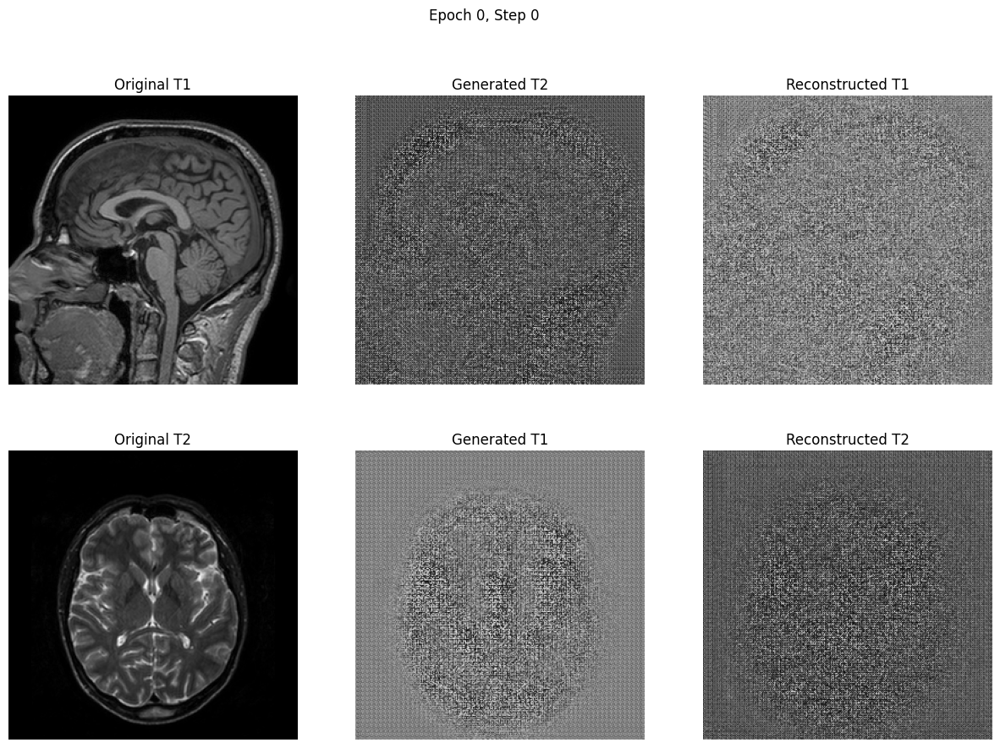

Epoch [0/1] Step [100/581] G: 1.7310 D_X: 0.3652 D_Y: 0.2222 Cyc: 0.9362 Idt: 0.0568


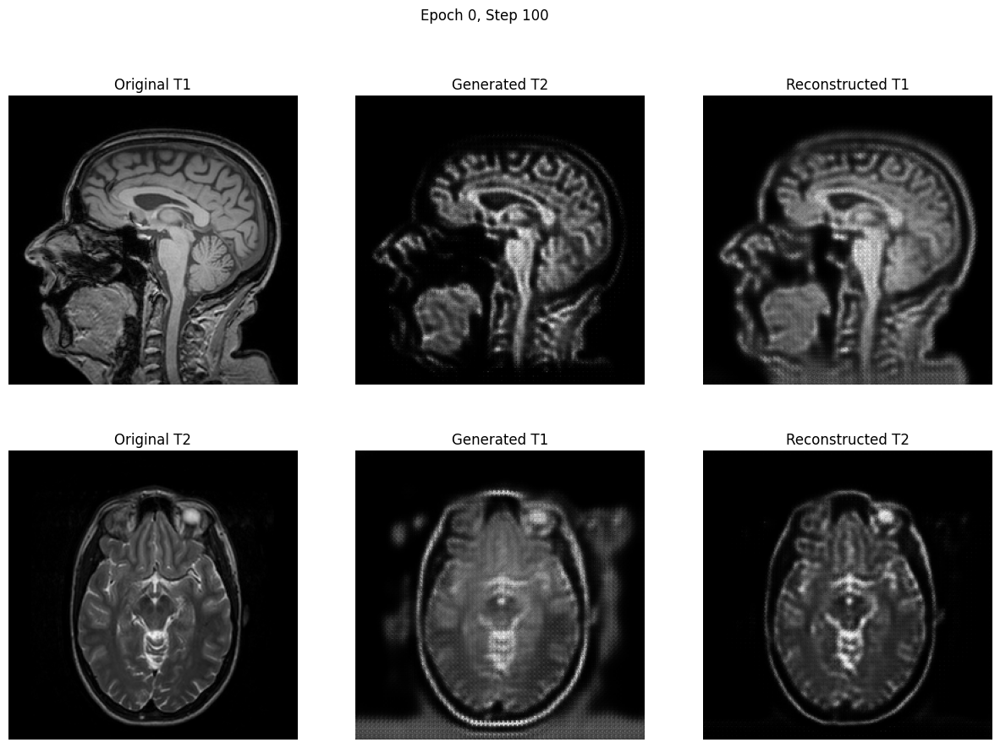

Epoch [0/1] Step [200/581] G: 2.3549 D_X: 0.2373 D_Y: 0.2649 Cyc: 1.6383 Idt: 0.0862


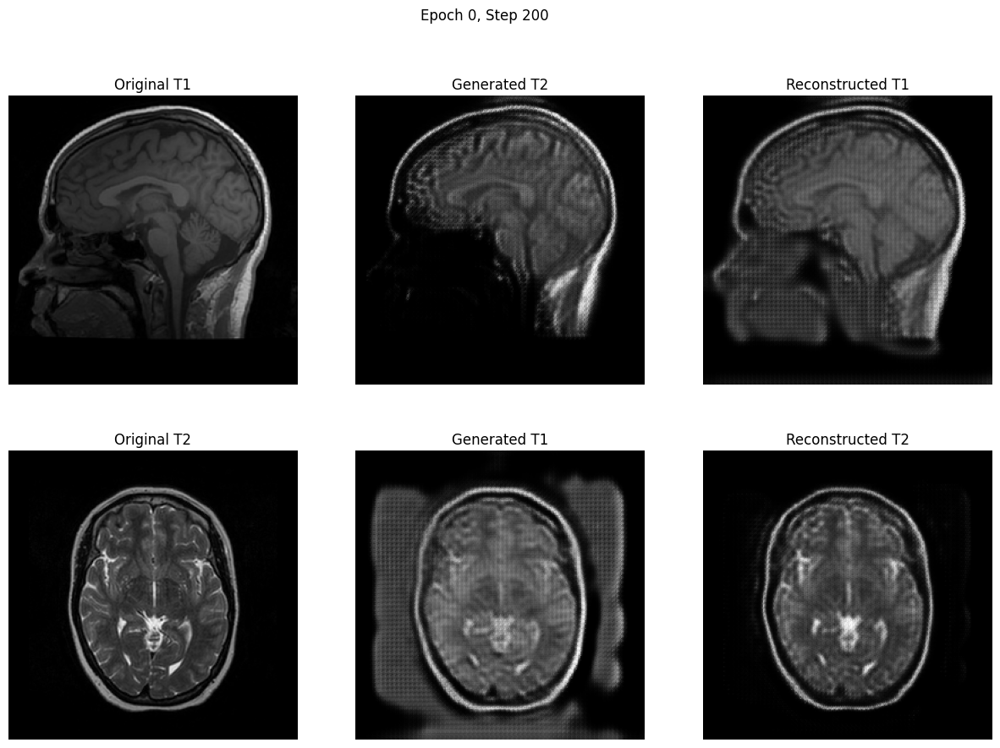

Epoch [0/1] Step [300/581] G: 1.9837 D_X: 0.1788 D_Y: 0.2250 Cyc: 1.1977 Idt: 0.0744


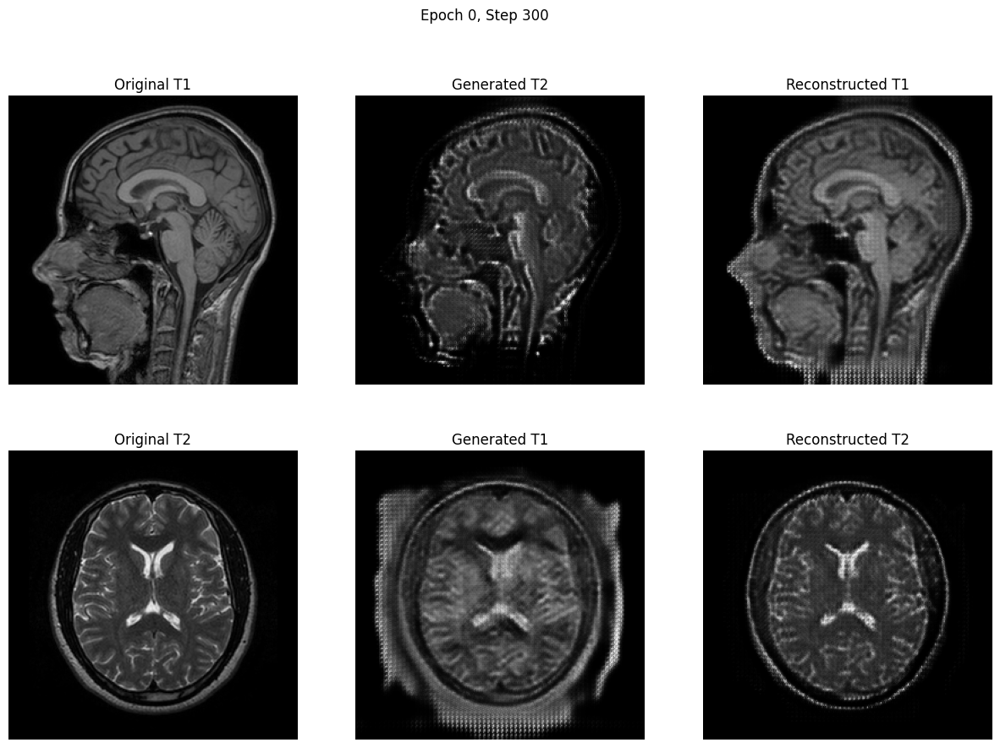

Epoch [0/1] Step [400/581] G: 2.3187 D_X: 0.1832 D_Y: 0.1565 Cyc: 1.3616 Idt: 0.0817


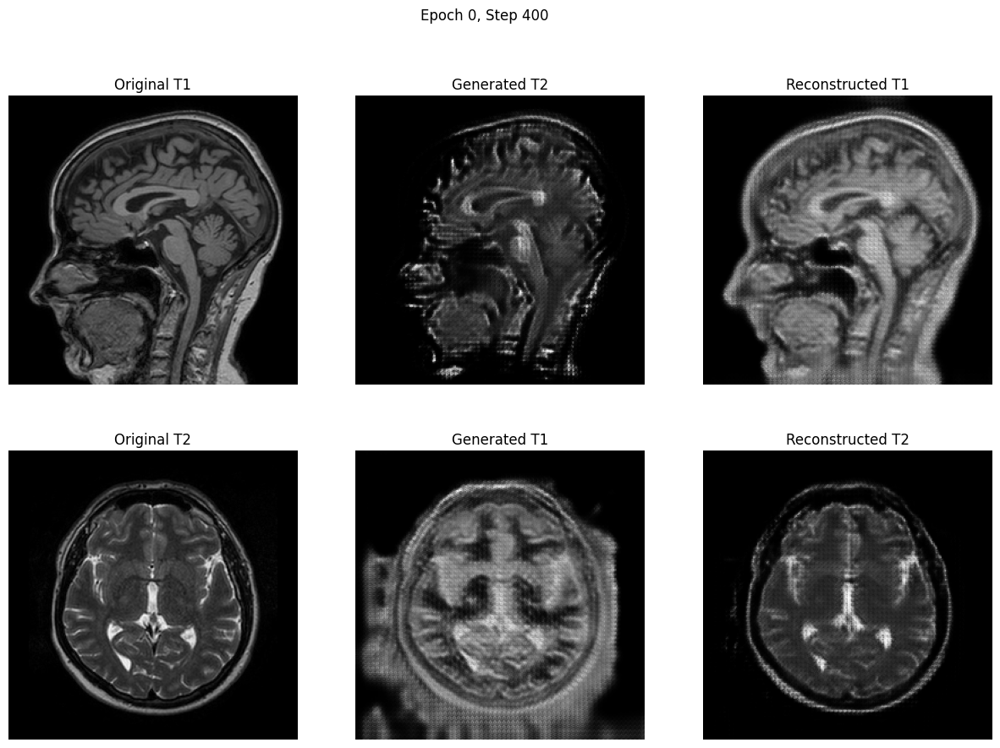

Epoch [0/1] Step [500/581] G: 2.2298 D_X: 0.1952 D_Y: 0.1613 Cyc: 1.4817 Idt: 0.0836


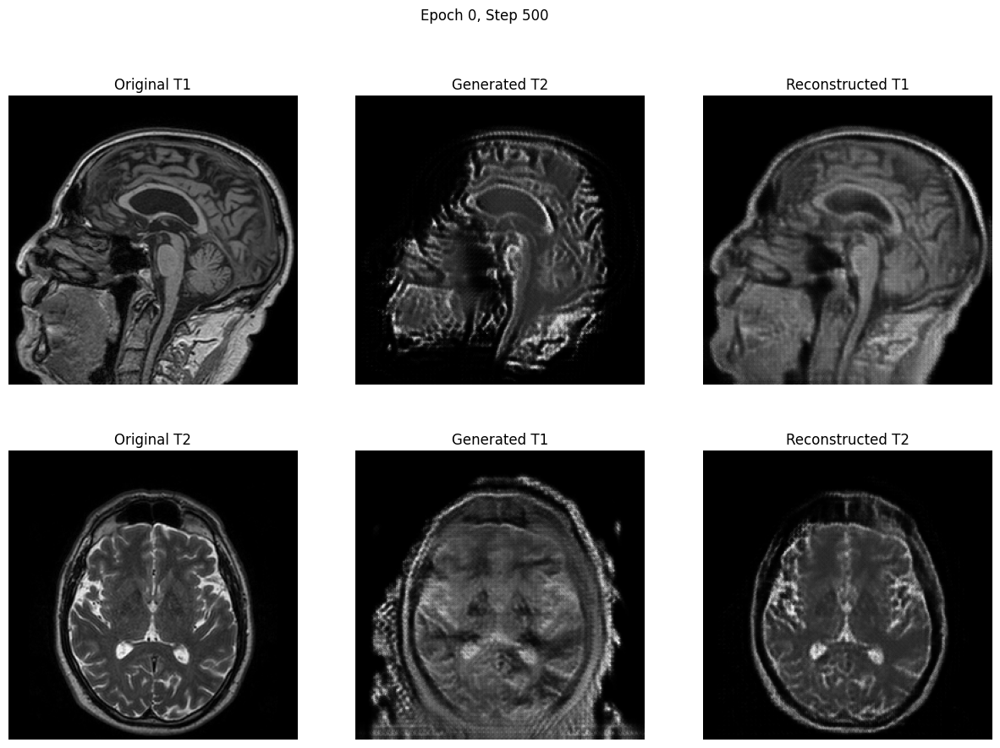

Saved checkpoint: checkpoints/2025_02_23/checkpoint_epoch_0.pth
End of epoch 0 / 1 	 Time Taken: 717.75 sec


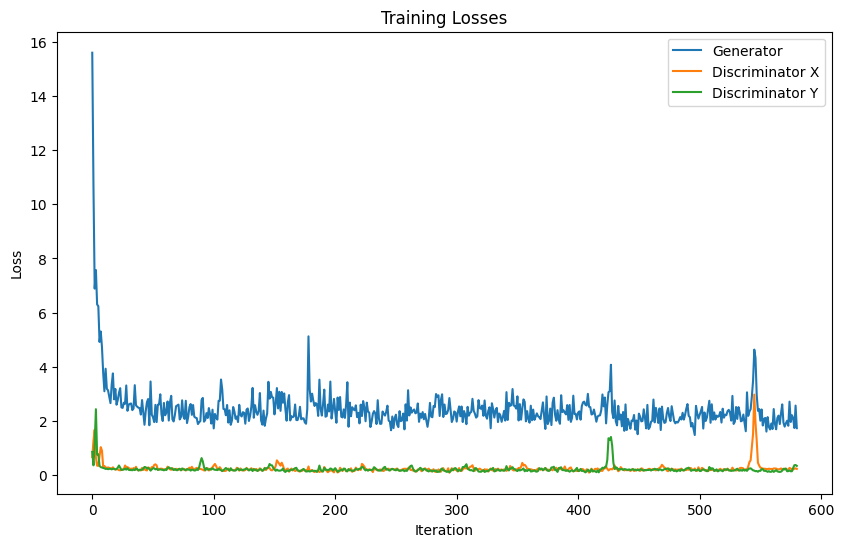

Epoch [1/1] Step [0/581] G: 1.8479 D_X: 0.2169 D_Y: 0.2506 Cyc: 1.3344 Idt: 0.0700


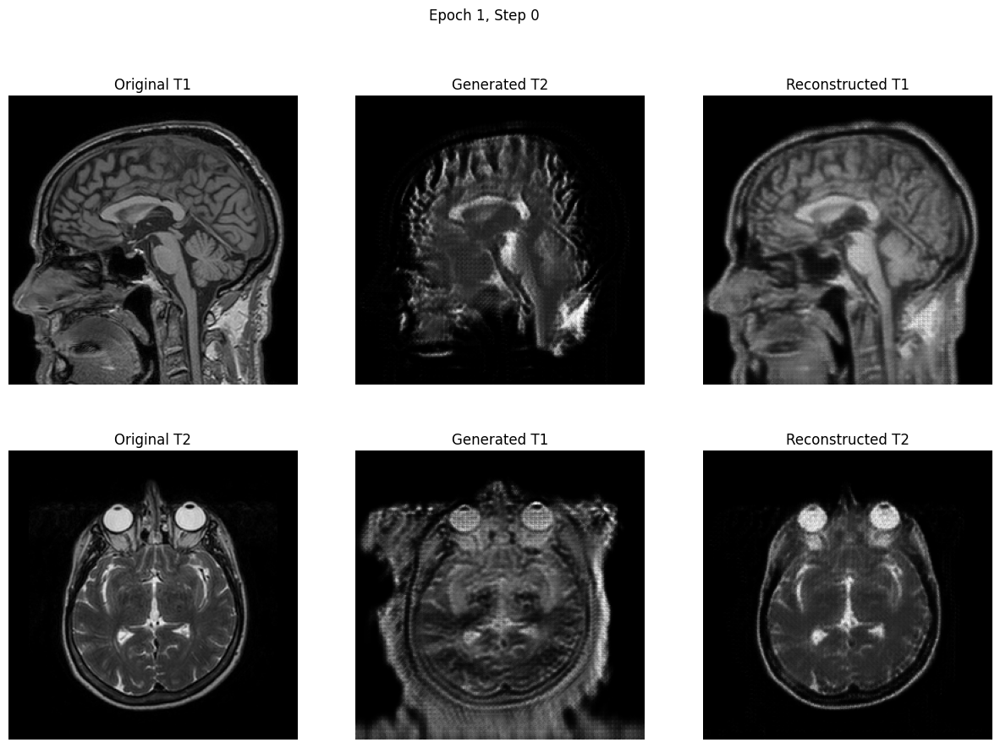

Epoch [1/1] Step [100/581] G: 2.0621 D_X: 0.1477 D_Y: 0.1840 Cyc: 1.3164 Idt: 0.0648


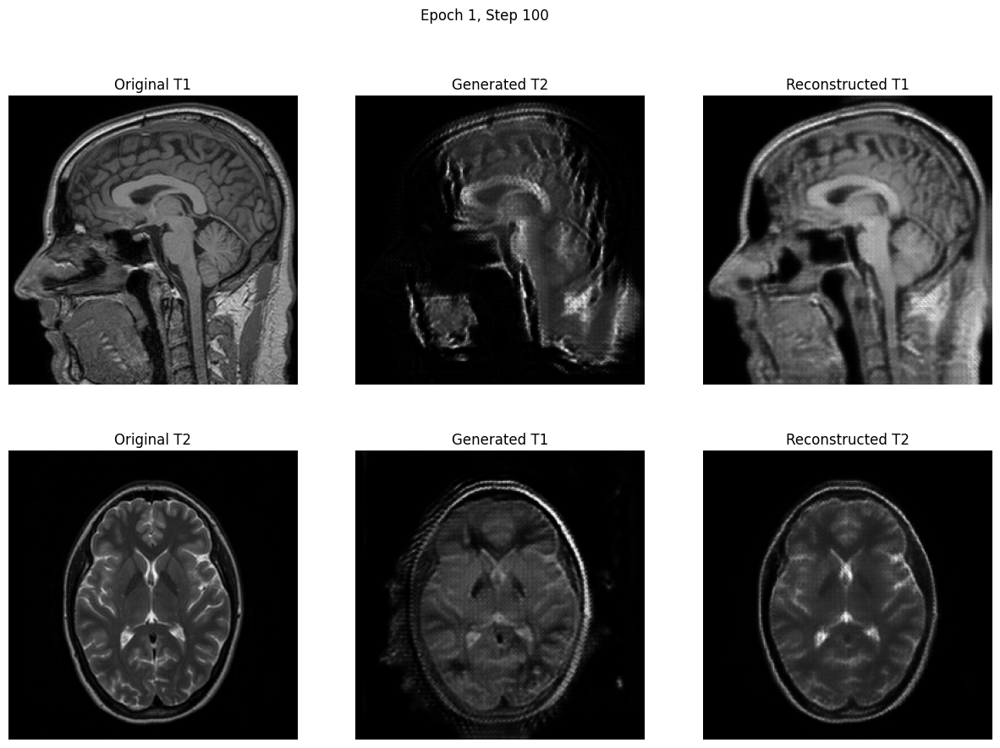

Epoch [1/1] Step [200/581] G: 2.4655 D_X: 0.2402 D_Y: 0.0984 Cyc: 1.6053 Idt: 0.0845


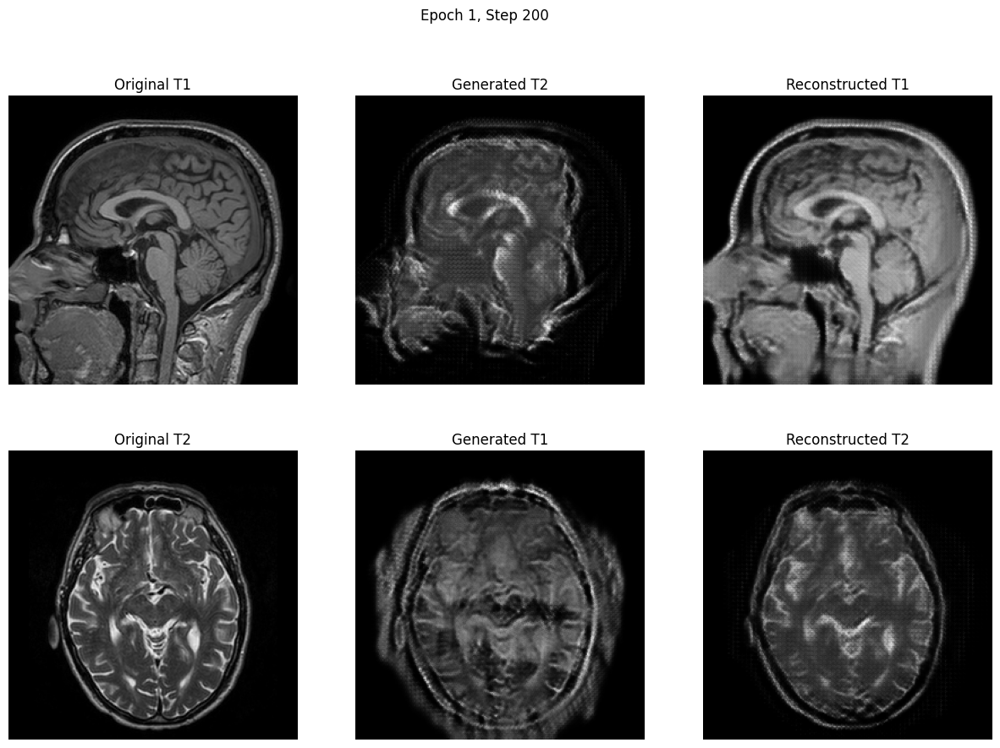

Epoch [1/1] Step [300/581] G: 1.8601 D_X: 0.2274 D_Y: 0.2172 Cyc: 1.0627 Idt: 0.0625


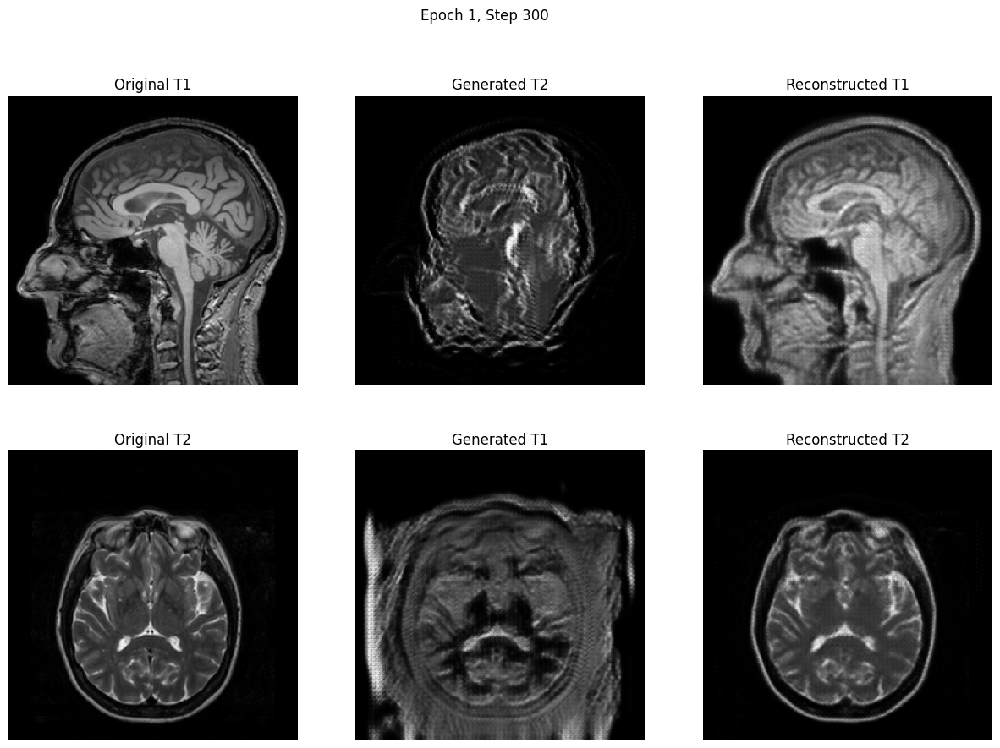

Epoch [1/1] Step [400/581] G: 2.0930 D_X: 0.1608 D_Y: 0.2113 Cyc: 1.3278 Idt: 0.0713


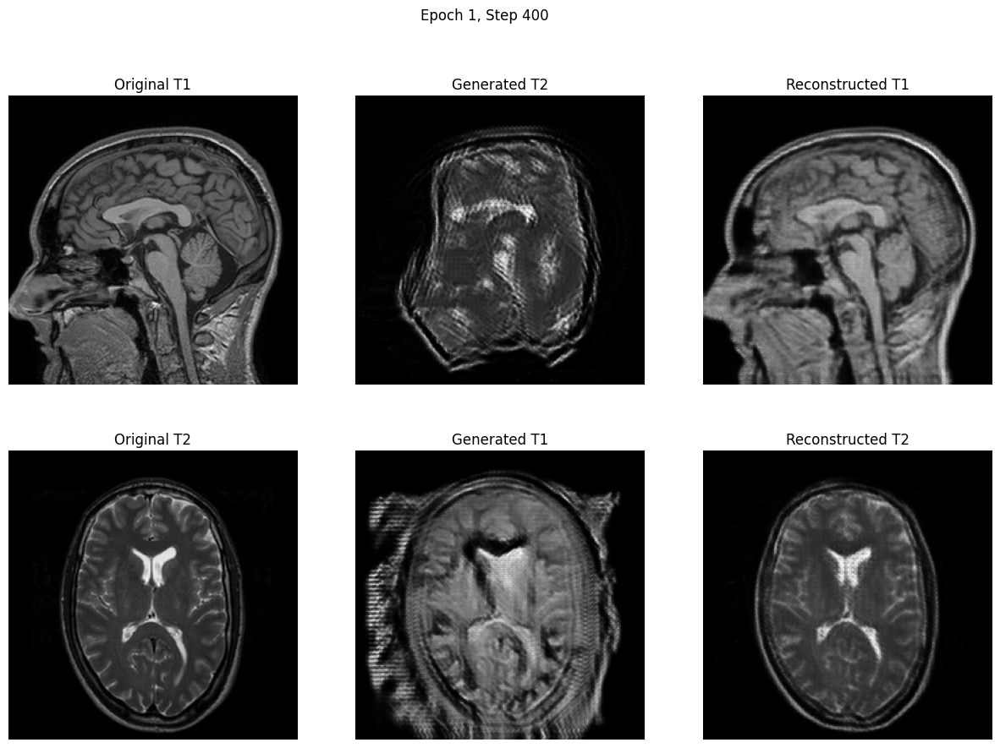

Epoch [1/1] Step [500/581] G: 1.8022 D_X: 0.2169 D_Y: 0.1767 Cyc: 1.1921 Idt: 0.0676


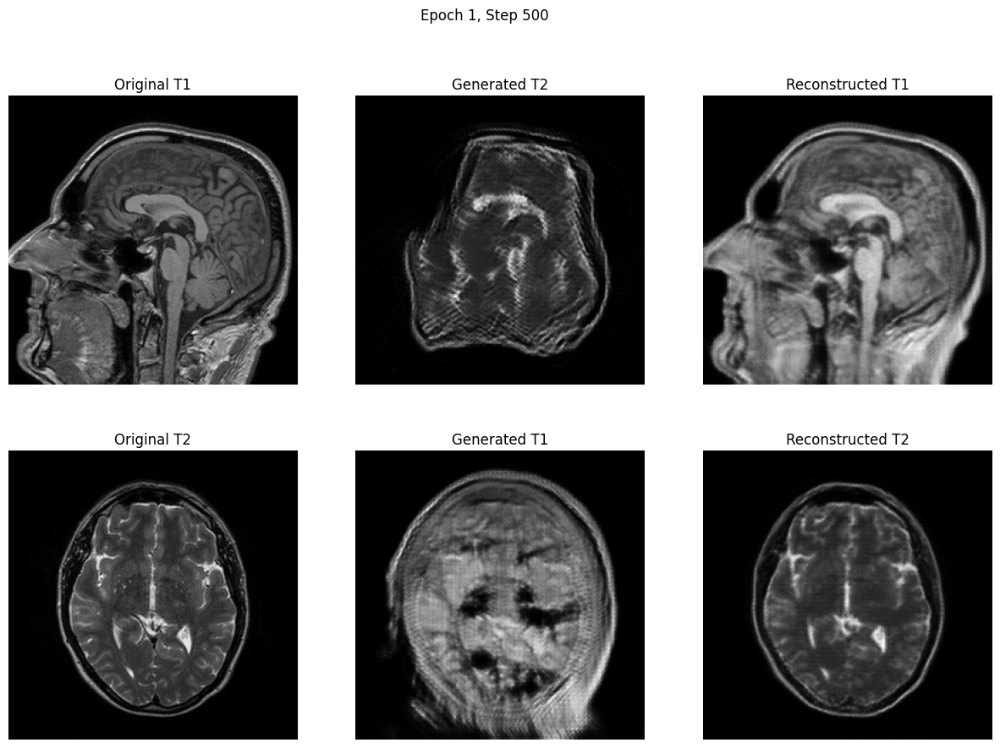

Saved checkpoint: checkpoints/2025_02_23/checkpoint_epoch_1.pth
End of epoch 1 / 1 	 Time Taken: 560.28 sec


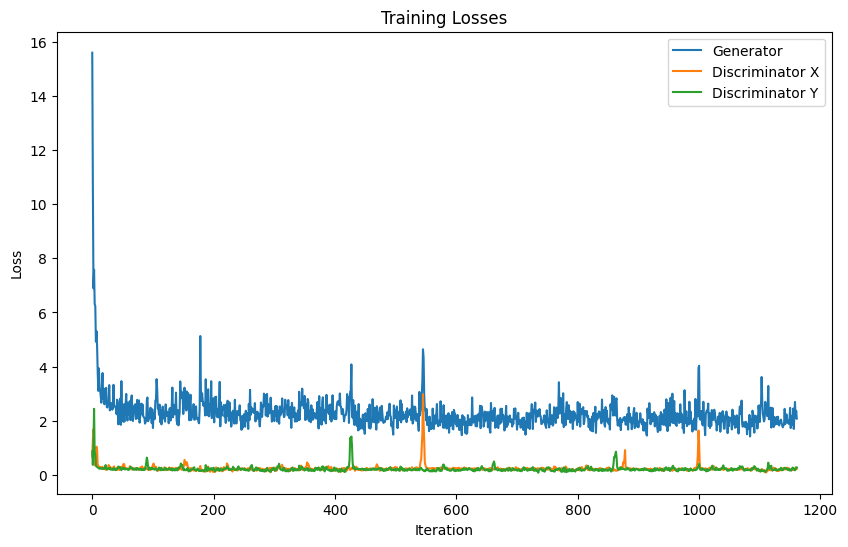

In [39]:
import os
import time
from datetime import datetime
import torch
import matplotlib.pyplot as plt
    
def train_cyclegan(model, dataloader, num_epochs=5, device="cuda", resume_training=True):
    """
    Train the CycleGAN model with checkpoint saving and visualization
    
    Args:
        model: CycleGAN model instance
        dataloader: DataLoader with training data
        num_epochs: Number of epochs to train
        device: Device to train on
        resume_training: Whether to look for and resume from latest checkpoint
    """
    
    # Create checkpoint directory structure
    base_checkpoint_dir = 'checkpoints'
    current_date = datetime.now().strftime('%Y_%m_%d')
    checkpoint_dir = os.path.join(base_checkpoint_dir, current_date)
    os.makedirs(checkpoint_dir, exist_ok=True)
    
    # Create visualization directory
    vis_dir = os.path.join('visualizations', current_date)
    os.makedirs(vis_dir, exist_ok=True)
    
    # Initialize starting epoch and history
    start_epoch = 0
    
    # Look for latest checkpoint if resume_training is True
    if resume_training:
        checkpoints = sorted([f for f in os.listdir(checkpoint_dir) if f.endswith('.pth')])
        if checkpoints:
            latest_checkpoint = os.path.join(checkpoint_dir, checkpoints[-1])
            print(f"Resuming from checkpoint: {latest_checkpoint}")
            
            checkpoint = torch.load(latest_checkpoint)
            model.G_XtoY.load_state_dict(checkpoint['G_XtoY_state'])
            model.G_YtoX.load_state_dict(checkpoint['G_YtoX_state'])
            model.D_X.load_state_dict(checkpoint['D_X_state'])
            model.D_Y.load_state_dict(checkpoint['D_Y_state'])
            model.opt_G.load_state_dict(checkpoint['opt_G_state'])
            model.opt_D_X.load_state_dict(checkpoint['opt_D_X_state'])
            model.opt_D_Y.load_state_dict(checkpoint['opt_D_Y_state'])
            model.scheduler_G.load_state_dict(checkpoint['scheduler_G_state'])
            model.scheduler_D_X.load_state_dict(checkpoint['scheduler_D_X_state'])
            model.scheduler_D_Y.load_state_dict(checkpoint['scheduler_D_Y_state'])
            model.history = checkpoint['history']
            start_epoch = checkpoint['epoch'] + 1
            print(f"Resuming from epoch {start_epoch}")
    
    def save_checkpoint(epoch, model, checkpoint_dir):
        checkpoint = {
            'epoch': epoch,
            'G_XtoY_state': model.G_XtoY.state_dict(),
            'G_YtoX_state': model.G_YtoX.state_dict(),
            'D_X_state': model.D_X.state_dict(),
            'D_Y_state': model.D_Y.state_dict(),
            'opt_G_state': model.opt_G.state_dict(),
            'opt_D_X_state': model.opt_D_X.state_dict(),
            'opt_D_Y_state': model.opt_D_Y.state_dict(),
            'scheduler_G_state': model.scheduler_G.state_dict(),
            'scheduler_D_X_state': model.scheduler_D_X.state_dict(),
            'scheduler_D_Y_state': model.scheduler_D_Y.state_dict(),
            'history': model.history
        }
        path = os.path.join(checkpoint_dir, f'checkpoint_epoch_{epoch}.pth')
        torch.save(checkpoint, path)
        print(f"Saved checkpoint: {path}")
    
    def visualize_progress(epoch, step, batch, generated_images, save_dir):
        """Save and display progress images"""
        fig, axes = plt.subplots(2, 3, figsize=(15, 10))
        
        # First row: T1 → T2
        axes[0,0].imshow(batch['T1'][0,0].cpu().numpy().T, cmap='gray', origin='lower')
        axes[0,0].set_title('Original T1')
        axes[0,1].imshow(generated_images['fake_Y'][0,0].detach().cpu().numpy().T, cmap='gray', origin='lower')
        axes[0,1].set_title('Generated T2')
        axes[0,2].imshow(generated_images['rec_X'][0,0].detach().cpu().numpy().T, cmap='gray', origin='lower')
        axes[0,2].set_title('Reconstructed T1')
        
        # Second row: T2 → T1
        axes[1,0].imshow(batch['T2'][0,0].cpu().numpy().T, cmap='gray', origin='lower')
        axes[1,0].set_title('Original T2')
        axes[1,1].imshow(generated_images['fake_X'][0,0].detach().cpu().numpy().T, cmap='gray', origin='lower')
        axes[1,1].set_title('Generated T1')
        axes[1,2].imshow(generated_images['rec_Y'][0,0].detach().cpu().numpy().T, cmap='gray', origin='lower')
        axes[1,2].set_title('Reconstructed T2')
        
        for ax in axes.flat:
            ax.axis('off')
        
        plt.suptitle(f'Epoch {epoch}, Step {step}')
        
        # Save figure
        save_path = os.path.join(save_dir, f'progress_epoch_{epoch}_step_{step}.png')
        plt.savefig(save_path)
        plt.show()
        plt.close()
    
    print(f"Starting training from epoch {start_epoch}")
    
    # Training loop
    for epoch in range(start_epoch, start_epoch + num_epochs):
        epoch_start_time = time.time()
        
        for i, batch in enumerate(dataloader):
            # Set model input
            model.set_input(batch['T1'], batch['T2'])
            
            # Generate images
            model.forward()
            
            # Update networks
            model.optimize()
            
            # Store losses
            model.history['G_losses'].append(model.loss_G.item())
            model.history['D_X_losses'].append(model.loss_D_X.item())
            model.history['D_Y_losses'].append(model.loss_D_Y.item())
            model.history['cycle_losses'].append((model.loss_cycle_X + model.loss_cycle_Y).item())
            model.history['identity_losses'].append((model.loss_idt_X + model.loss_idt_Y).item())
            
            # Print progress (every 100 steps, standard for CycleGAN)
            if i % 100 == 0:
                print(f"Epoch [{epoch}/{start_epoch + num_epochs-1}] "
                      f"Step [{i}/{len(dataloader)}] "
                      f"G: {model.loss_G.item():.4f} "
                      f"D_X: {model.loss_D_X.item():.4f} "
                      f"D_Y: {model.loss_D_Y.item():.4f} "
                      f"Cyc: {(model.loss_cycle_X + model.loss_cycle_Y).item():.4f} "
                      f"Idt: {(model.loss_idt_X + model.loss_idt_Y).item():.4f}")
                
                # Visualize progress
                generated_images = {
                    'fake_Y': model.fake_Y,
                    'fake_X': model.fake_X,
                    'rec_X': model.rec_X,
                    'rec_Y': model.rec_Y
                }
                visualize_progress(epoch, i, batch, generated_images, vis_dir)
        
        # Update learning rates
        model.scheduler_G.step()
        model.scheduler_D_X.step()
        model.scheduler_D_Y.step()
        
        # Save checkpoint after each epoch
        save_checkpoint(epoch, model, checkpoint_dir)
        
        epoch_time = time.time() - epoch_start_time
        print(f'End of epoch {epoch} / {start_epoch + num_epochs-1} \t Time Taken: {epoch_time:.2f} sec')
        
        # Plot and save loss curves
        model.plot_losses()
        plt.savefig(os.path.join(vis_dir, f'losses_epoch_{epoch}.png'))
        plt.close()

# Example usage:
# Check for CUDA first
if torch.cuda.is_available():
    device = "cuda"
# Then check for M1/M2/M3 Mac GPUs
elif hasattr(torch.backends, "mps") and torch.backends.mps.is_available():
    device = " mps"
# Fall back to CPU
else:
    device = "cpu"
print(f"Using device: {device}")
cyclegan = CycleGAN(device=device)
train_cyclegan(cyclegan, dataloader, num_epochs=2, device=device)

## 7. Visualization & Conclusion
We provide a helper function to visualize T1→T2. We'll show real T1, generated T2, and real T2 side-by-side.

In [25]:
def visualize_t1_to_t2(model, x, y, device="cuda"):
    import matplotlib.pyplot as plt
    model.G_XtoY.eval()
    with torch.no_grad():
        x = x.to(device)
        fake_y = model.G_XtoY(x)
    model.G_XtoY.train()

    # Assume batch_size=1
    real_x = x[0].cpu().numpy()[0]
    real_y = y[0].cpu().numpy()[0]
    gen_y  = fake_y[0].cpu().numpy()[0]

    def rescale(img):
        return (img - img.min()) / (img.max() - img.min() + 1e-8)

    real_x = rescale(real_x)
    real_y = rescale(real_y)
    gen_y  = rescale(gen_y)

    fig, axs = plt.subplots(1, 3, figsize=(10,4))
    axs[0].imshow(real_x, cmap="gray")
    axs[0].set_title("Input T1")
    axs[0].axis("off")

    axs[1].imshow(gen_y, cmap="gray")
    axs[1].set_title("Generated T2")
    axs[1].axis("off")

    axs[2].imshow(real_y, cmap="gray")
    axs[2].set_title("Real T2")
    axs[2].axis("off")

    plt.show()

# Example usage after training:
# x_batch, y_batch = next(iter(loader))
# visualize_t1_to_t2(cyclegan, x_batch, y_batch, device=device)


### Summary
- We adapted a **CycleGAN** for MRI T1→T2 using the **IXI** dataset.
- This demonstration is 2D slice-based; for real applications, consider 3D volumes or specialized methods.
- Evaluate with domain-specific metrics (SSIM, PSNR, or clinical metrics) to ensure medical relevance.

Thank you, and enjoy experimenting!